# MANUAL NET ARCHITECTURE

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import os
import glob
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.models import Sequential
from PIL import Image

from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Activation

from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt

In [3]:
A10 = 'datasets/train/A10'
B52 = 'datasets/train/B52'
C17 = 'datasets/train/C17'
F4 = 'datasets/train/F4'
Passenger_Aircraft = 'datasets/train/Passenger_Aircraft'

In [4]:
def plot_images(item_dir, n=6):
    all_item_dir = os.listdir(item_dir)
    item_files = [os.path.join(item_dir, file) for file in all_item_dir][:n]
    
    plt.figure(figsize=(80, 40))
    for idx, img_path in enumerate(item_files):
        plt.subplot(3, n, idx+1)
        img = plt.imread(img_path)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
    
    plt.tight_layout()
    
def image_details_print(data,path):
    print('======== Images in: ', path)
    for key,values in data.items():
        print(key,':\t', values)


def images_details(path):
    files=[f for f in glob.glob(path + "**/*.*", recursive=True)]
    data={}
    data['Images_count']=len(files)
    data['Min_width']=10**100
    data['Max_width']=0
    data['Min_height']=10**100
    data['Max_height']=0
    
    for f in files:
        img=Image.open(f)
        width,height=img.size
        data['Min_width']=min(width,data['Min_width'])
        data['Max_width']=max(width, data['Max_width'])
        data['Min_height']=min(height, data['Min_height'])
        data['Max_height']=max(height, data['Max_height'])
        
    image_details_print(data,path)


TRAINING DATA FOR A10:

======== Images in:  datasets/train/A10
Images_count :	 200
Min_width :	 32
Max_width :	 4687
Min_height :	 11
Max_height :	 3119



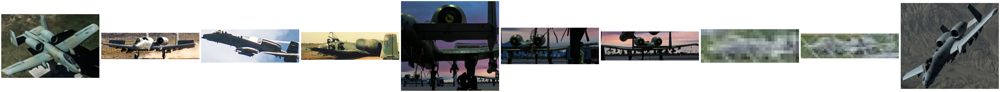

In [5]:
print("")
print("TRAINING DATA FOR A10:")
print("")
images_details(A10)
print("")
plot_images(A10, 10) 


TRAINING DATA FOR B52:

======== Images in:  datasets/train/B52
Images_count :	 200
Min_width :	 47
Max_width :	 4095
Min_height :	 23
Max_height :	 2224



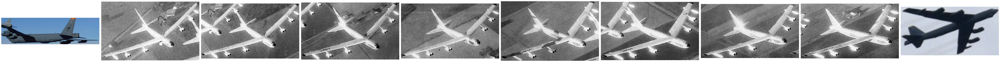

In [6]:
print("")
print("TRAINING DATA FOR B52:")
print("")
images_details(B52)
print("")
plot_images(B52, 10)


TRAINING DATA FOR C17:

======== Images in:  datasets/train/C17
Images_count :	 200
Min_width :	 61
Max_width :	 4927
Min_height :	 19
Max_height :	 3279



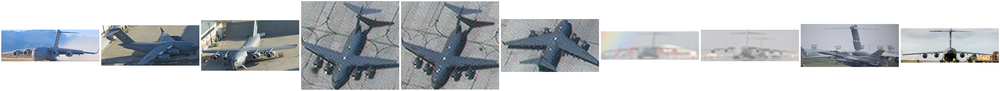

In [7]:
print("")
print("TRAINING DATA FOR C17:")
print("")
images_details(C17)
print("")
plot_images(C17, 10)


TRAINING DATA FOR F4:

======== Images in:  datasets/train/F4
Images_count :	 200
Min_width :	 50
Max_width :	 3560
Min_height :	 36
Max_height :	 1568



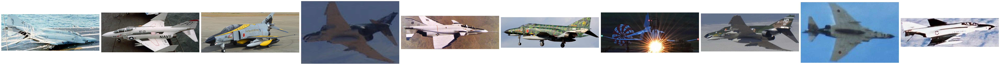

In [8]:
print("")
print("TRAINING DATA FOR F4:")
print("")
images_details(F4)
print("")
plot_images(F4, 10)


TRAINING DATA FOR Passenger_Aircraft:

======== Images in:  datasets/train/Passenger_Aircraft
Images_count :	 200
Min_width :	 800
Max_width :	 1600
Min_height :	 477
Max_height :	 1112



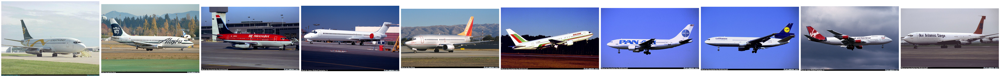

In [9]:
print("")
print("TRAINING DATA FOR Passenger_Aircraft:")
print("")
images_details(Passenger_Aircraft)
print("")
plot_images(Passenger_Aircraft, 10)

In [10]:
train_datagen=ImageDataGenerator(rescale=1./255,shear_range=0.2,zoom_range=0.2,horizontal_flip=True)
training_set=train_datagen.flow_from_directory('datasets/train',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 4000 images belonging to 20 classes.


In [11]:
test_datagen=ImageDataGenerator(rescale=1./255)
test_set=test_datagen.flow_from_directory('datasets/test',target_size=(224,224),batch_size=32,class_mode='categorical')

Found 2000 images belonging to 20 classes.


In [12]:
Classifier=Sequential()
Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
Classifier.add(MaxPooling2D(pool_size=(8,8)))
# Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
# Classifier.add(MaxPooling2D(pool_size=(8,8)))
# Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
# Classifier.add(MaxPooling2D(pool_size=(8,8)))
# Classifier.add(Convolution2D(32,(3,3),input_shape=(224,224,3),activation='relu'))
# Classifier.add(MaxPooling2D(pool_size=(8,8)))
Classifier.add(Flatten())
Classifier.add(Dense(38, activation='relu'))
Classifier.add(Dense(20, activation='softmax'))
Classifier.compile(optimizer='rmsprop',loss='categorical_crossentropy',metrics=['accuracy'])

In [13]:
model_path = "MANUAL.h5"

callbacks = [
    ModelCheckpoint(model_path, monitor='accuracy', verbose=1, save_best_only=True)
]

In [14]:
epochs = 10
batch_size = 512

In [15]:
#### Fitting the model
history = Classifier.fit(
           training_set, steps_per_epoch=training_set.samples // batch_size, 
           epochs=epochs, 
           validation_data=test_set,validation_steps=test_set.samples // batch_size,
           callbacks=callbacks)

Epoch 1/10


7/7 [==============================] - ETA: 0s - loss: 3.9229 - accuracy: 0.0625
Epoch 1: accuracy improved from -inf to 0.06250, saving model to MANUAL.h5
7/7 [==============================] - 17s 2s/step - loss: 3.9229 - accuracy: 0.0625 - val_loss: 3.0976 - val_accuracy: 0.0312
Epoch 2/10
7/7 [==============================] - ETA: 0s - loss: 3.0848 - accuracy: 0.0223
Epoch 2: accuracy did not improve from 0.06250
7/7 [==============================] - 14s 2s/step - loss: 3.0848 - accuracy: 0.0223 - val_loss: 3.0063 - val_accuracy: 0.0521
Epoch 3/10
7/7 [==============================] - ETA: 0s - loss: 2.9975 - accuracy: 0.0536
Epoch 3: accuracy did not improve from 0.06250
7/7 [==============================] - 13s 2s/step - loss: 2.9975 - accuracy: 0.0536 - val_loss: 2.9954 - val_accuracy: 0.0521
Epoch 4/10
7/7 [==============================] - ETA: 0s - loss: 2.9847 - accuracy: 0.0759
Epoch 4: accuracy improved from 0.06250 to 0.07589, saving model to MANUAL.h5
7/

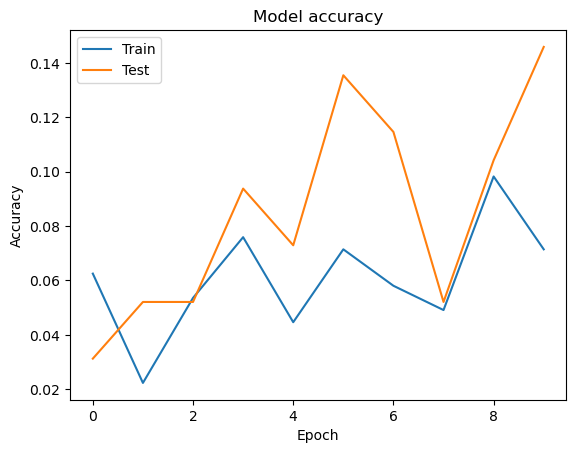

In [16]:
import matplotlib.pyplot as plt

def graph():
    #Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()

graph()

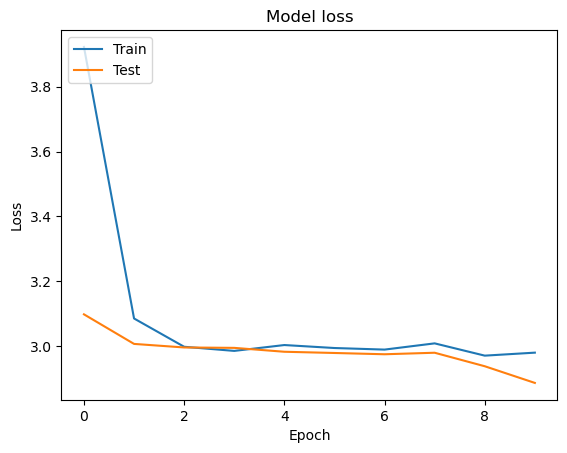

In [17]:
import matplotlib.pyplot as plt

def graph():
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    plt.show()
graph()